## 테이블 불러오기 

In [0]:
%sql 

select * from hive_metastore.test.california_cocount_final6;

##co-count 테이블에 위도, 경도 정보 join

In [0]:
test1=spark.sql(f"SELECT gmap_id, latitude, longitude FROM hive_metastore.test.california_meta_lanlon_changed")

test2=spark.sql(f"SELECT * FROM hive_metastore.test.california_cocount_final6")

test3 = test2.join(test1.withColumnRenamed("gmap_id", "gmap_id1")
                             .withColumnRenamed("Latitude", "lat1")
                             .withColumnRenamed("Longitude", "lon1"),
                       on="gmap_id1", how="inner") \
                 .join(test1.withColumnRenamed("gmap_id", "gmap_id2")
                             .withColumnRenamed("Latitude", "lat2")
                             .withColumnRenamed("Longitude", "lon2"),
                       on="gmap_id2", how="inner")

display(test3)

gmap_id2,gmap_id1,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2
0x80c29c222a915d6b:0xf4a3d1e659f4fb94,0x80c29ba0e8d07a7f:0x790bc0a814ab5195,1,393,724,2021-2,2021,2,1.482176040152979E-8,0.002544529262086514,0.0013812154696132596,237.12049611291525,5.468568434349609,2.3749690949483404,8.960573476702509E-4,34.234083,-118.55242,34.1864309,-118.60637039999999
0x80ea6a7c0ab6dfcb:0x9cc3c5f305e2fce4,0x80ea4299316257db:0x6f6e3a00fe7209ab,1,1248,483,2019-4,2019,4,1.482176040152979E-8,8.012820512820513E-4,0.002070393374741201,111.92793604342518,4.717855236022641,2.0489384954229966,5.780346820809249E-4,35.419909,-119.052116,35.331322199999995,-119.0387136
0x808fcbecebb99ca3:0xebc9a72051541d43,0x808e2e23f1d48943:0x1636a069564b294,1,1632,458,2017-3,2017,3,1.482176040152979E-8,6.127450980392157E-4,0.002183406113537118,90.26400082412877,4.5027387189663495,1.9555145790992026,4.786979415988511E-4,37.2466217,-121.80296129999999,37.3708636,-121.9172157
0x809b4ddc1c2121cf:0x8a3645b636434c76,0x54ce0b32e5fd4c59:0x273e12228abc2852,1,1046,758,2020-1,2020,1,1.482176040152979E-8,9.560229445506692E-4,0.0013192612137203166,85.09407492798297,4.443757408337347,1.9298993213576052,5.546311702717693E-4,41.423164199999995,-122.3927796,39.0769586,-121.54319989999999
0x808fb7ad6decff03:0xb60dff98613d96f9,0x80858088a8d29d65:0x66ea6ea931d71077,1,3178,1213,2019-4,2019,4,1.482176040152979E-8,3.1466331025802394E-4,8.244023083264633E-4,17.501912883140843,2.8623101825638755,1.2430855177829803,2.2779043280182233E-4,37.7886897,-122.4071735,37.3955388,-122.0280205
0x808fb574a96dd96d:0xc9081c6e682de4b1,0x808e340037cbc9a3:0xe17bcf2b5b883b5a,1,379,434,2019-1,2019,1,1.482176040152979E-8,0.002638522427440633,0.002304147465437788,410.1769694685262,6.016588699421756,2.612971272040331,0.0012315270935960591,37.2398536,-121.9041211,37.3163858,-122.0157967
0x80dc9bc7f45e9357:0xbf61792eedff7f85,0x80db7fb631f28661:0xef6a63e9feda3f98,1,899,178,2019-1,2019,1,1.482176040152979E-8,0.0011123470522803114,0.0056179775280898875,421.6193335916312,6.044102853840881,2.6249205174787913,9.293680297397769E-4,33.5010687,-117.1492365,33.659447199999995,-117.30162759999999
0x80c2cd82698dacb7:0x4c2fb5d51b1b8242,0x80c2cc4c31257685:0x4ced4daa2b0d7a40,1,485,9998,2016-2,2016,2,1.482176040152979E-8,0.002061855670103093,1.0002000400080016E-4,13.913786674860745,2.6328801956935877,1.143445340502079,9.540164090822362E-5,33.936811999999996,-118.1606868,33.9358204,-118.1197356
0x80c2bf29bc1422a5:0x12e506f7fe702fd4,0x80c2972e64eaab3f:0x27c5763dcbdd07f8,1,1028,1595,2018-2,2018,2,1.482176040152979E-8,9.727626459143969E-4,6.269592476489029E-4,41.14778002756669,3.7171699773705313,1.6143464094684572,3.8138825324180017E-4,34.2153944,-118.44931799999999,34.0916924,-118.34449459999999
0x809adf1b69786ab3:0xba5c831026ab2e97,0x809ade25f6cc5043:0x82b0b81c89ef8508,1,1880,265,2020-3,2020,3,1.482176040152979E-8,5.319148936170213E-4,0.0037735849056603774,135.424265355279,4.90841255679437,2.1316964883204266,4.664179104477612E-4,38.6797524,-121.2709938,38.6802178,-121.3199384


In [0]:
%sql 

select * from hive_metastore.test.california_meta_lanlon_changed
where gmap_id = "0x80c29ba0e8d07a7f:0x790bc0a814ab5195";

gmap_id,MISC,address,avg_rating,category,description,hours,latitude,longitude,name,num_of_reviews,price,relative_results,state,url,region,main_category
0x80c29ba0e8d07a7f:0x790bc0a814ab5195,"List(List(Wheelchair accessible entrance), null, null, null, null, null, null, null, null, null, null, null, List(Debit cards, NFC mobile payments), List(Quick visit), null, null, null)","85°C Bakery Cafe - Northridge, 9046 Tampa Ave, Northridge, CA 91324",4.4,"List(Bakery, Cafe, Coffee shop, Dessert shop, Restaurant)","Bakery/cafe chain with roots in Taiwan, offering coffee & tea plus international desserts & breads.","List(List(Monday, 7AM–9PM), List(Tuesday, 7AM–9PM), List(Wednesday, 7AM–9PM), List(Thursday, 7AM–9PM), List(Friday, 7AM–9PM), List(Saturday, 7AM–9PM), List(Sunday, 8AM–9PM))",34.234083,-118.55242,85°C Bakery Cafe - Northridge,418,$,"List(0x80c29ba236d28da9:0xc4a6597ee3413514, 0x80c29b72fd990551:0x749fc625ebec759e, 0x80c29baba834f255:0x506e9290b5f24065, 0x80c29d0c39981cbf:0x62f8792edb368c70)",Open ⋅ Closes 9PM,https://www.google.com/maps/place//data=!4m2!3m1!1s0x80c29ba0e8d07a7f:0x790bc0a814ab5195?authuser=-1&hl=en&gl=us,California,Food & Beverage


### gmap_id1, gmap_id2 열 순서 재배치 

In [0]:
from pyspark.sql.functions import col

# test3 DataFrame의 열 이름 목록을 구하고, gmap_id1과 gmap_id2의 순서를 변경합니다.
# 여기서는 예시로 몇 가지 열 이름만 나열했지만, 실제 열 이름을 사용해야 합니다.
column_order = ["gmap_id1", "gmap_id2", "co_count", "gmap_count1", "gmap_count2", "year_quarter", "year", "quarter", "support", "confidence", "confidence2", "lift", "lift_log", "lift_log10", "jaccard", "lat1", "lon1", "lat2", "lon2"]  # 필요한 열들을 적절히 추가/재배열
# 열 순서를 변경합니다.
test3_reordered = test3.select([col(c) for c in column_order])

# 변경된 순서로 데이터를 출력합니다.
display(test3_reordered)

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2
0x80c29ba0e8d07a7f:0x790bc0a814ab5195,0x80c29c222a915d6b:0xf4a3d1e659f4fb94,1,393,724,2021-2,2021,2,1.482176040152979E-8,0.002544529262086514,0.0013812154696132596,237.12049611291525,5.468568434349609,2.3749690949483404,8.960573476702509E-4,34.234083,-118.55242,34.1864309,-118.60637039999999
0x80ea4299316257db:0x6f6e3a00fe7209ab,0x80ea6a7c0ab6dfcb:0x9cc3c5f305e2fce4,1,1248,483,2019-4,2019,4,1.482176040152979E-8,8.012820512820513E-4,0.002070393374741201,111.92793604342518,4.717855236022641,2.0489384954229966,5.780346820809249E-4,35.419909,-119.052116,35.331322199999995,-119.0387136
0x808e2e23f1d48943:0x1636a069564b294,0x808fcbecebb99ca3:0xebc9a72051541d43,1,1632,458,2017-3,2017,3,1.482176040152979E-8,6.127450980392157E-4,0.002183406113537118,90.26400082412877,4.5027387189663495,1.9555145790992026,4.786979415988511E-4,37.2466217,-121.80296129999999,37.3708636,-121.9172157
0x54ce0b32e5fd4c59:0x273e12228abc2852,0x809b4ddc1c2121cf:0x8a3645b636434c76,1,1046,758,2020-1,2020,1,1.482176040152979E-8,9.560229445506692E-4,0.0013192612137203166,85.09407492798297,4.443757408337347,1.9298993213576052,5.546311702717693E-4,41.423164199999995,-122.3927796,39.0769586,-121.54319989999999
0x80858088a8d29d65:0x66ea6ea931d71077,0x808fb7ad6decff03:0xb60dff98613d96f9,1,3178,1213,2019-4,2019,4,1.482176040152979E-8,3.1466331025802394E-4,8.244023083264633E-4,17.501912883140843,2.8623101825638755,1.2430855177829803,2.2779043280182233E-4,37.7886897,-122.4071735,37.3955388,-122.0280205
0x808e340037cbc9a3:0xe17bcf2b5b883b5a,0x808fb574a96dd96d:0xc9081c6e682de4b1,1,379,434,2019-1,2019,1,1.482176040152979E-8,0.002638522427440633,0.002304147465437788,410.1769694685262,6.016588699421756,2.612971272040331,0.0012315270935960591,37.2398536,-121.9041211,37.3163858,-122.0157967
0x80db7fb631f28661:0xef6a63e9feda3f98,0x80dc9bc7f45e9357:0xbf61792eedff7f85,1,899,178,2019-1,2019,1,1.482176040152979E-8,0.0011123470522803114,0.0056179775280898875,421.6193335916312,6.044102853840881,2.6249205174787913,9.293680297397769E-4,33.5010687,-117.1492365,33.659447199999995,-117.30162759999999
0x80c2cc4c31257685:0x4ced4daa2b0d7a40,0x80c2cd82698dacb7:0x4c2fb5d51b1b8242,1,485,9998,2016-2,2016,2,1.482176040152979E-8,0.002061855670103093,1.0002000400080016E-4,13.913786674860745,2.6328801956935877,1.143445340502079,9.540164090822362E-5,33.936811999999996,-118.1606868,33.9358204,-118.1197356
0x80c2972e64eaab3f:0x27c5763dcbdd07f8,0x80c2bf29bc1422a5:0x12e506f7fe702fd4,1,1028,1595,2018-2,2018,2,1.482176040152979E-8,9.727626459143969E-4,6.269592476489029E-4,41.14778002756669,3.7171699773705313,1.6143464094684572,3.8138825324180017E-4,34.2153944,-118.44931799999999,34.0916924,-118.34449459999999
0x809ade25f6cc5043:0x82b0b81c89ef8508,0x809adf1b69786ab3:0xba5c831026ab2e97,1,1880,265,2020-3,2020,3,1.482176040152979E-8,5.319148936170213E-4,0.0037735849056603774,135.424265355279,4.90841255679437,2.1316964883204266,4.664179104477612E-4,38.6797524,-121.2709938,38.6802178,-121.3199384


In [0]:
# 조건에 맞는 데이터를 필터링하여 확인
filtered_df = test3_reordered.filter(col("gmap_id1") == "0x80d953dbffb2491d:0xf4bbd0e491709ae0")
display(filtered_df)

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d953deaafc7805:0xcc0116c18c2fae93,1,38,332,2017-1,2017,1,1.482176040152979E-8,0.02631578947368421,0.0030120481927710845,5347.841550412175,8.584448309961711,3.7281785312000677,0.0027100271002710027,32.547716,-117.033483,32.706542999999996,-117.08618
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d955115e5b142b:0x404bd0f41428847c,1,38,1304,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,7.668711656441718E-4,1361.5670205037134,7.216391536391603,3.1340390235082025,7.457121551081282E-4,32.547716,-117.033483,32.775598099999996,-117.1448394
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d956a4ee8adabb:0x21c7fbebb6fdff5f,1,38,1835,2018-3,2018,3,1.482176040152979E-8,0.02631578947368421,5.449591280653951E-4,967.5658826903772,6.87478351838953,2.985680546315996,5.341880341880342E-4,32.547716,-117.033483,32.7495335,-117.0701709
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d956ca8c1cf899:0xa2b4d08667ec69d8,1,38,1086,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,9.208103130755065E-4,1634.8834205679946,7.39932677838432,3.2134867896512755,8.904719501335708E-4,32.547716,-117.033483,32.741855699999995,-117.0547529
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d954dcd6fbe193:0xbb3e2aef31e810c1,1,38,33,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,0.030303030303030304,53802.52711323764,10.89307571741172,4.730802675026216,0.014285714285714285,32.547716,-117.033483,32.7481863,-117.15323839999999
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80deaae5bd04003f:0xb9064d252dcb82f7,1,38,1534,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,6.51890482398957E-4,1157.4207266863377,7.053949296950999,3.063491255291142,6.365372374283895E-4,32.547716,-117.033483,32.7552233,-117.2052363
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80deaae350bbc8f1:0x495ddf7634b204a8,1,38,1088,2017-1,2017,1,1.482176040152979E-8,0.02631578947368421,9.191176470588235E-4,1631.8781201625386,7.397486851462313,3.2126877195419428,8.888888888888889E-4,32.547716,-117.033483,32.7506209,-117.20828669999999
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d956cab7636471:0xdbd9d9565a5bc8c4,1,38,548,2019-1,2019,1,1.482176040152979E-8,0.02631578947368421,0.0018248175182481751,3239.933202074529,8.083307991930186,3.5105360564197348,0.0017094017094017094,32.547716,-117.033483,32.7401675,-117.0546371
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d959d3eed70c65:0xaf8162afcff2456b,1,38,998,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,0.001002004008016032,1779.0414776922266,7.483830002566737,3.250186073616733,9.66183574879227E-4,32.547716,-117.033483,32.7947492,-116.9782824
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d953fca23fdef3:0xebb3b31186704459,1,38,27,2017-1,2017,1,1.482176040152979E-8,0.02631578947368421,0.037037037037037035,65758.64424951267,11.093746412873871,4.817952850745117,0.015625,32.547716,-117.033483,32.7232088,-117.08353419999999


In [0]:
test3_reordered.write.saveAsTable('hive_metastore.test.cali_cocount_distance_all_final')

In [0]:
%sql 

select count(*) from hive_metastore.test.cali_cocount_distance_all_final;

count(*)
346540103


In [0]:
%sql 

select count(*) from hive_metastore.test.california_cocount_final6;

count(*)
346540103


## 거리계산

In [0]:
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.types import DoubleType
from pyspark.sql.functions import pandas_udf
import pandas as pd
import math

class LatLongCalc():
    def cal_lat_log_dist(self, df, lat1, lon1, lat2, lon2):
        @pandas_udf(DoubleType())
        def vincenty_distance(lat1: pd.Series, lon1: pd.Series, lat2: pd.Series, lon2: pd.Series) -> pd.Series:
            def calc_distance(lat1, lon1, lat2, lon2):
                a = 6378137.0
                f = 1 / 298.257223563
                b = (1 - f) * a

                lat1, lon1, lat2, lon2 = map(math.radians, [lat1, lon1, lat2, lon2])
                L = lon2 - lon1
                U1 = math.atan((1 - f) * math.tan(lat1))
                U2 = math.atan((1 - f) * math.tan(lat2))
                sinU1 = math.sin(U1)
                cosU1 = math.cos(U1)
                sinU2 = math.sin(U2)
                cosU2 = math.cos(U2)

                lambda_ = L
                for _ in range(1000):
                    sinLambda = math.sin(lambda_)
                    cosLambda = math.cos(lambda_)
                    sinSigma = math.sqrt((cosU2 * sinLambda) ** 2 +
                                         (cosU1 * sinU2 - sinU1 * cosU2 * cosLambda) ** 2)
                    if sinSigma == 0:  # Points are coincident
                        return 0.0
                    cosSigma = sinU1 * sinU2 + cosU1 * cosU2 * cosLambda
                    sigma = math.atan2(sinSigma, cosSigma)
                    sinAlpha = cosU1 * cosU2 * sinLambda / sinSigma
                    cos2Alpha = 1 - sinAlpha ** 2
                    if cos2Alpha == 0:  # Points are on the equatorial line
                        cos2SigmaM = 0
                    else:
                        cos2SigmaM = cosSigma - 2 * sinU1 * sinU2 / cos2Alpha
                    C = f / 16 * cos2Alpha * (4 + f * (4 - 3 * cos2Alpha))
                    lambdaPrev = lambda_
                    lambda_ = L + (1 - C) * f * sinAlpha * (
                            sigma + C * sinSigma * (
                            cos2SigmaM + C * cosSigma * (
                            -1 + 2 * cos2SigmaM ** 2)))

                    if abs(lambda_ - lambdaPrev) < 1e-12:
                        break
                else:
                    return None

                u2 = cos2Alpha * (a ** 2 - b ** 2) / (b ** 2)
                A = 1 + u2 / 16384 * (4096 + u2 * (-768 + u2 * (320 - 175 * u2)))
                B = u2 / 1024 * (256 + u2 * (-128 + u2 * (74 - 47 * u2)))
                deltaSigma = B * sinSigma * (
                        cos2SigmaM + B / 4 * (
                        cosSigma * (-1 + 2 * cos2SigmaM ** 2) -
                        B / 6 * cos2SigmaM * (-3 + 4 * sinSigma ** 2) *
                        (-3 + 4 * cos2SigmaM ** 2)))

                s = b * A * (sigma - deltaSigma)
                return round(s / 1000, 4)

            distances = [calc_distance(lat1[i], lon1[i], lat2[i], lon2[i]) for i in range(len(lat1))]
            return pd.Series(distances)

        df = df.withColumn('distance_in_kms', 
                           vincenty_distance(F.col(lat1), F.col(lon1), F.col(lat2), F.col(lon2)))
        return df
    

if __name__ == "__main__":
    spark = SparkSession.builder.appName("Distance Calculation").getOrCreate()

    # Read the existing table into a DataFrame
    cali_cocount = spark.read.table('hive_metastore.test.cali_cocount_distance_all_final')

    # Create an instance of the LatLongCalc class
    calc = LatLongCalc()
    
    # Calculate the distance between the coordinates
    df = calc.cal_lat_log_dist(cali_cocount, "lat1", "lon1", "lat2", "lon2")

    # Show the results
    df.show()

+--------------------+--------------------+--------+-----------+-----------+------------+----+-------+--------------------+--------------------+--------------------+------------------+------------------+------------------+--------------------+------------------+-------------------+------------------+-------------------+---------------+
|            gmap_id1|            gmap_id2|co_count|gmap_count1|gmap_count2|year_quarter|year|quarter|             support|          confidence|         confidence2|              lift|          lift_log|        lift_log10|             jaccard|              lat1|               lon1|              lat2|               lon2|distance_in_kms|
+--------------------+--------------------+--------+-----------+-----------+------------+----+-------+--------------------+--------------------+--------------------+------------------+------------------+------------------+--------------------+------------------+-------------------+------------------+-------------------+---

In [0]:
# 서버리스 사용하여 저장
df.write.mode("overwrite").saveAsTable("hive_metastore.test.cali_cocount_distance_all_result_final_4")

In [0]:
%sql 
-- 거리가 1000km 이상인 것들 데이터 확인 
select * from hive_metastore.test.cali_cocount_distance_all_result_final_3
where distance_in_kms >= 1000; 

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2,distance_in_kms
0x54d066374e5772d1:0xb441da8fecff353b,0x80dcc85fbe23ffff:0xaa6b06278e1fe138,1,424,48,2019-3,2019,3,1.482176040152979E-8,0.0023584905660377358,0.020833333333333332,3315.0731623427673,8.106234972464739,3.5204931175525944,0.0021231422505307855,41.755555199999996,-124.19595749999999,33.879385899999996,-117.5950609,1048.9975
0x54d1556717dee239:0x623a5805f0e702a5,0x80d94ec27431a30d:0x28f90b2f6e67e678,1,352,2908,2018-1,2018,1,1.482176040152979E-8,0.002840909090909091,3.43878954607978E-4,65.91179602507191,4.188317424353079,1.818963145855783,3.068425897514575E-4,40.7997289,-124.174824,32.5877434,-117.0063651,1113.018
0x54d2eccc35e51bd3:0x7a87c6ede6d08028,0x80d94ec27431a30d:0x28f90b2f6e67e678,1,290,2908,2018-1,2018,1,1.482176040152979E-8,0.0034482758620689655,3.43878954607978E-4,80.00328345112176,4.3820676769706575,1.9031078114349578,3.1279324366593683E-4,40.583894699999995,-122.3561835,32.5877434,-117.0063651,1007.7376
0x54d157a568900a2f:0x1f302570e666bbdd,0x80d94ec27431a30d:0x28f90b2f6e67e678,1,393,2908,2018-2,2018,2,1.482176040152979E-8,0.002544529262086514,3.43878954607978E-4,59.035501783270504,4.078138988081915,1.7711132589584873,3.0303030303030303E-4,40.8582927,-124.07289589999999,32.5877434,-117.0063651,1113.0367
0x54d150aa80db05af:0xeb73c1061c7f6458,0x80dbe8a8bac3e4f9:0x7d35a09edfdfa32a,1,282,18,2017-4,2017,4,1.482176040152979E-8,0.0035460992907801418,0.05555555555555555,13291.64085894405,9.494890609770309,4.123578598098247,0.0033444816053511705,40.902522399999995,-124.08415679999999,33.0351405,-116.8800887,1082.5409
0x54d2ecb9802e2c9f:0xf8cb7aa46f805134,0x80d94ec27431a30d:0x28f90b2f6e67e678,1,965,2908,2018-1,2018,1,1.482176040152979E-8,0.0010362694300518134,3.43878954607978E-4,24.04243751380861,3.179820498612191,1.3809784959901212,2.5826446280991736E-4,40.5724164,-122.35765119999999,32.5877434,-117.0063651,1006.6959
0x54d105a6f44465f5:0x8b4ad7e0f7a32bf4,0x80dce867e7f4037f:0x4fed4e3c8f4be739,1,137,432,2019-3,2019,3,1.482176040152979E-8,0.0072992700729927005,0.0023148148148148147,1139.9764970262233,7.038762924532351,3.0568958975495955,0.0017605633802816902,41.3215949,-124.0451908,33.6314528,-117.71536909999999,1020.0641
0x54d157043c2dce1f:0x49169be277058a98,0x80d95359be6ba41d:0x6fc4da1a82b2771e,1,368,405,2020-1,2020,1,1.482176040152979E-8,0.002717391304347826,0.0024691358024691358,452.686319108964,6.115199433329116,2.6557973696327277,0.0012953367875647669,40.866247,-124.0903,32.711186999999995,-117.1599825,1095.3401
0x54d4056a26dcca05:0xc2f42b54cf4d0160,0x80dc7699285b6a67:0xe5192957077387dc,1,144,1734,2017-3,2017,3,1.482176040152979E-8,0.006944444444444444,5.767012687427913E-4,270.2020416826862,5.599169981688099,2.431688626285473,5.327650506126798E-4,40.6410639,-124.2236056,33.2021219,-117.2410067,1032.9499
0x54d2eb0ead53fb4f:0x80d26b287022d8c1,0x80d94ec27431a30d:0x28f90b2f6e67e678,1,555,2908,2018-3,2018,3,1.482176040152979E-8,0.0018018018018018018,3.43878954607978E-4,41.80351747896452,3.732980486204742,1.6212128262112375,2.8885037550548814E-4,40.5373738,-122.34841619999999,32.5877434,-117.0063651,1002.9362


## 이상치 자르기
- 캘리포니아 전체 거리 1391km -> 1391km 이상 인 것은 이상치로 판단 
- 이상치 기준 잡기
- 이상치 값은 null 값으로 변경 

In [0]:
# 캘리포니아 거리 계산 

# 북서쪽 : 위 42.0  경 -124.4
# 남동쪽 : 위 32.5 경 -114.1333
1391.1363

from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.types import DoubleType
from pyspark.sql.functions import pandas_udf
import pandas as pd
import math

class LatLongCalc():
    def cal_lat_log_dist(self, df, lat1, long1, lat2, long2):
        # Define a Pandas UDF to calculate geodesic distance using Vincenty formula
        @pandas_udf(DoubleType())
        def vincenty_distance(lat1: pd.Series, lon1: pd.Series, lat2: pd.Series, lon2: pd.Series) -> pd.Series:
            def calc_distance(lat1, lon1, lat2, lon2):
                # Constants for WGS-84
                a = 6378137.0  # major axis
                f = 1 / 298.257223563  # flattening
                b = (1 - f) * a  # minor axis

                # Convert degrees to radians
                lat1, lon1, lat2, lon2 = map(math.radians, [lat1, lon1, lat2, lon2])

                L = lon2 - lon1
                U1 = math.atan((1 - f) * math.tan(lat1))
                U2 = math.atan((1 - f) * math.tan(lat2))
                sinU1 = math.sin(U1)
                cosU1 = math.cos(U1)
                sinU2 = math.sin(U2)
                cosU2 = math.cos(U2)

                lambda_ = L
                for _ in range(1000):  # iteration limit to avoid infinite loop
                    sinLambda = math.sin(lambda_)
                    cosLambda = math.cos(lambda_)
                    sinSigma = math.sqrt((cosU2 * sinLambda) ** 2 +
                                         (cosU1 * sinU2 - sinU1 * cosU2 * cosLambda) ** 2)
                    cosSigma = sinU1 * sinU2 + cosU1 * cosU2 * cosLambda
                    sigma = math.atan2(sinSigma, cosSigma)
                    sinAlpha = cosU1 * cosU2 * sinLambda / sinSigma
                    cos2Alpha = 1 - sinAlpha ** 2
                    cos2SigmaM = cosSigma - 2 * sinU1 * sinU2 / cos2Alpha
                    C = f / 16 * cos2Alpha * (4 + f * (4 - 3 * cos2Alpha))
                    lambdaPrev = lambda_
                    lambda_ = L + (1 - C) * f * sinAlpha * (
                            sigma + C * sinSigma * (
                            cos2SigmaM + C * cosSigma * (
                            -1 + 2 * cos2SigmaM ** 2)))

                    # Break if change in lambda is insignificant
                    if abs(lambda_ - lambdaPrev) < 1e-12:
                        break
                else:
                    return None  # formula failed to converge

                u2 = cos2Alpha * (a ** 2 - b ** 2) / (b ** 2)
                A = 1 + u2 / 16384 * (4096 + u2 * (-768 + u2 * (320 - 175 * u2)))
                B = u2 / 1024 * (256 + u2 * (-128 + u2 * (74 - 47 * u2)))
                deltaSigma = B * sinSigma * (
                        cos2SigmaM + B / 4 * (
                        cosSigma * (-1 + 2 * cos2SigmaM ** 2) -
                        B / 6 * cos2SigmaM * (-3 + 4 * sinSigma ** 2) *
                        (-3 + 4 * cos2SigmaM ** 2)))

                s = b * A * (sigma - deltaSigma)
                return round(s / 1000, 4)  # distance in kilometers

            distances = [calc_distance(lat1[i], lon1[i], lat2[i], lon2[i]) for i in range(len(lat1))]
            return pd.Series(distances)

        # Apply the Pandas UDF to the dataframe
        df = df.withColumn('distance_in_kms', 
                           vincenty_distance(F.col(lat1), F.col(long1), F.col(lat2), F.col(long2)))
        return df

if __name__ == "__main__":
    spark = SparkSession.builder.appName("Distance Calculation").getOrCreate()

    # Create a DataFrame with the coordinates
    data = [("A", 42.0, -124.4, "B", 32.5, -114.1333)]

    df = spark.createDataFrame(data, ["coord1", "lat1", "long1", "coord2", "lat2", "long2"])

    # Calculate the distance between the coordinates
    calc = LatLongCalc()
    df = calc.cal_lat_log_dist(df, "lat1", "long1", "lat2", "long2")

    # Show the results
    df.show()

+------+----+------+------+----+---------+---------------+
|coord1|lat1| long1|coord2|lat2|    long2|distance_in_kms|
+------+----+------+------+----+---------+---------------+
|     A|42.0|-124.4|     B|32.5|-114.1333|      1391.1363|
+------+----+------+------+----+---------+---------------+



### 거리계산 분포 확인_시도 1

In [0]:
%sql 
-- 거리계산별 count

select distance_in_kms, count(*) as cnt from hive_metastore.test.cali_cocount_distance_all_result_final
group by distance_in_kms
order by cnt desc; 


distance_in_kms,cnt
0.0,13871
0.1115,2018
0.0884,2016
0.2085,1991
0.0921,1976
0.1292,1967
0.1781,1949
0.149,1944
0.1451,1942
0.0962,1940


Databricks visualization. Run in Databricks to view.

In [0]:
%sql
-- distance_in_kms를 범위로 나눠서 각 범위 내의 개수를 카운트하는 쿼리

SELECT 
    CASE
        WHEN distance_in_kms >= 0 AND distance_in_kms < 5 THEN '0-5'
        WHEN distance_in_kms >= 5 AND distance_in_kms < 10 THEN '5-10'
        WHEN distance_in_kms >= 10 AND distance_in_kms < 50 THEN '10-50'
        WHEN distance_in_kms >= 50 AND distance_in_kms < 100 THEN '50-100'
        WHEN distance_in_kms >= 100 AND distance_in_kms < 500 THEN '100-500'
        WHEN distance_in_kms >= 500 AND distance_in_kms < 1000 THEN '500-1000'
        WHEN distance_in_kms >= 1000 AND distance_in_kms < 5000 THEN '1000-5000'
        ELSE '5000+'
    END AS distance_range,
    COUNT(*) AS count
FROM 
    hive_metastore.test.cali_cocount_distance_all_result_final
GROUP BY 
    CASE
        WHEN distance_in_kms >= 0 AND distance_in_kms < 5 THEN '0-5'
        WHEN distance_in_kms >= 5 AND distance_in_kms < 10 THEN '5-10'
        WHEN distance_in_kms >= 10 AND distance_in_kms < 50 THEN '10-50'
        WHEN distance_in_kms >= 50 AND distance_in_kms < 100 THEN '50-100'
        WHEN distance_in_kms >= 100 AND distance_in_kms < 500 THEN '100-500'
        WHEN distance_in_kms >= 500 AND distance_in_kms < 1000 THEN '500-1000'
        WHEN distance_in_kms >= 1000 AND distance_in_kms < 5000 THEN '1000-5000'
        ELSE '5000+'
    END;

distance_range,count
500-1000,13293215
0-5,66018259
5-10,49884965
100-500,48794525
1000-5000,104780
10-50,129938340
50-100,38506019


In [0]:
%sql
SELECT
    MIN(distance_in_kms) AS min_distance,
    MAX(distance_in_kms) AS max_distance,
    AVG(distance_in_kms) AS avg_distance,
    PERCENTILE(distance_in_kms, 0.5) AS median_distance,
    STDDEV(distance_in_kms) AS stddev_distance
FROM
    hive_metastore.test.cali_cocount_distance_all_result_final;

min_distance,max_distance,avg_distance,median_distance,stddev_distance
0.0,3720.0572,71.9081641822684,19.4881,136.79126418683052


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import when, count

# SparkSession 생성 및 Hive 연결
spark = SparkSession.builder \
    .appName("HiveDataLoad") \
    .enableHiveSupport() \
    .getOrCreate()

# Hive 테이블 로드
df = spark.sql("SELECT distance_in_kms FROM hive_metastore.test.cali_cocount_distance_all_result_final")

# 각 범위에 해당하는 조건을 사용해 그룹화 컬럼 추가
df_grouped = df.withColumn(
    "distance_group",
    when(col("distance_in_kms") < 5, "0-5")
    .when((col("distance_in_kms") >= 5) & (col("distance_in_kms") < 10), "5-10")
    .when((col("distance_in_kms") >= 10) & (col("distance_in_kms") < 50), "10-50")
    .when((col("distance_in_kms") >= 50) & (col("distance_in_kms") < 100), "50-100")
    .when((col("distance_in_kms") >= 100) & (col("distance_in_kms") < 500), "100-500")
    .when((col("distance_in_kms") >= 500) & (col("distance_in_kms") < 1000), "500-1000")
    .when((col("distance_in_kms") >= 1000) & (col("distance_in_kms") < 5000), "1000-5000")
    .otherwise("5000+")
)

# 그룹별 데이터 개수 집계
grouped_counts = df_grouped.groupBy("distance_group").agg(count("*").alias("count"))

# 결과를 Pandas DataFrame으로 변환
pandas_grouped_counts = grouped_counts.toPandas()


In [0]:
# Pandas DataFrame 데이터 확인
print(pandas_grouped_counts)

  distance_group      count
0       500-1000   13293215
1            0-5   66018259
2           5-10   49884965
3        100-500   48794525
4      1000-5000     104780
5          10-50  129938340
6         50-100   38506019


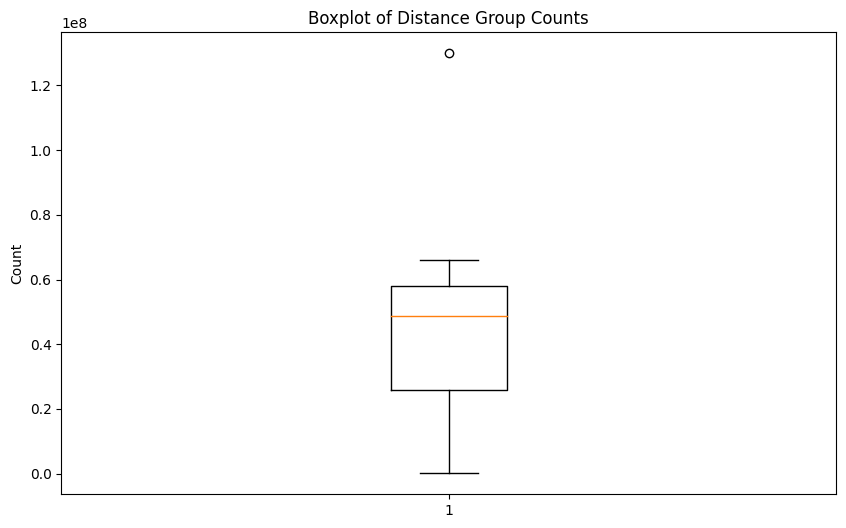

In [0]:
import matplotlib.pyplot as plt

# Pandas DataFrame에서 distance_in_kms 값을 추출하여 Boxplot 생성
plt.figure(figsize=(10, 6))
plt.boxplot(pandas_grouped_counts['count'])
plt.title('Boxplot of Distance Group Counts')
plt.ylabel('Count')
plt.show()

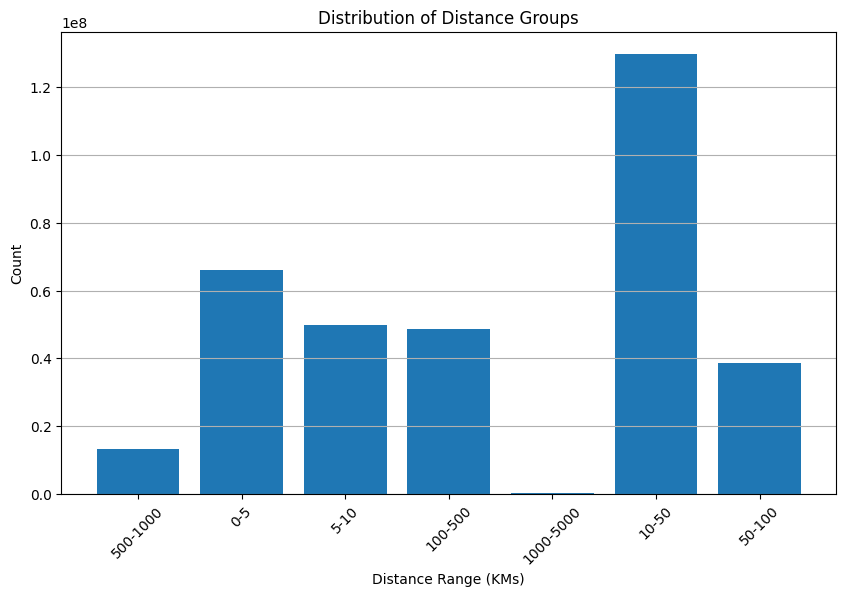

In [0]:
import matplotlib.pyplot as plt

# Bar Plot 생성
plt.figure(figsize=(10, 6))
plt.bar(pandas_grouped_counts['distance_group'], pandas_grouped_counts['count'])
plt.title('Distribution of Distance Groups')
plt.xlabel('Distance Range (KMs)')
plt.ylabel('Count')
plt.xticks(rotation=45)  # x축 라벨을 회전하여 가독성 향상
plt.grid(axis='y')  # y축 기준으로 그리드 추가
plt.show()


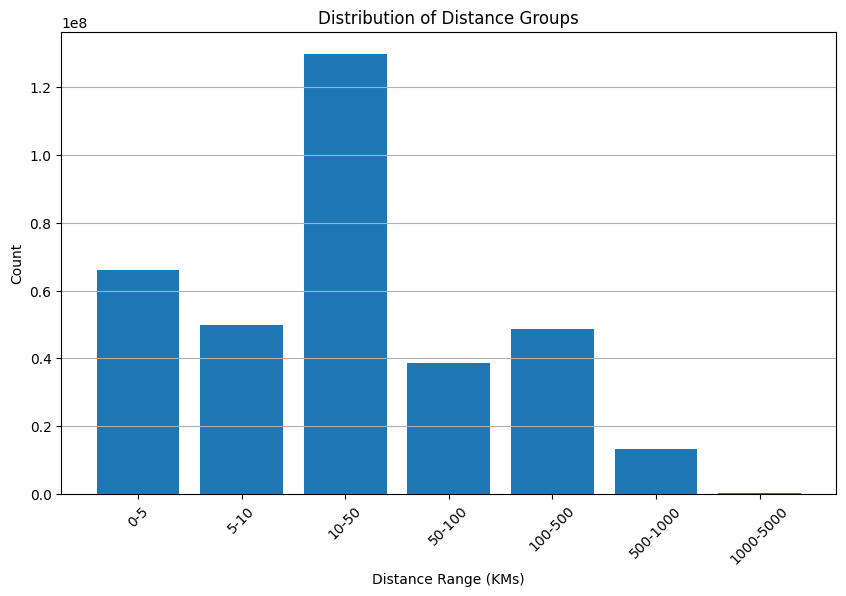

In [0]:
import matplotlib.pyplot as plt
import pandas as pd

# 지정된 순서대로 x축을 구성하기 위한 순서 리스트
order = ["0-5", "5-10", "10-50", "50-100", "100-500", "500-1000", "1000-5000"]

# distance_group 컬럼을 Categorical 타입으로 변환하고, 순서를 지정
pandas_grouped_counts['distance_group'] = pd.Categorical(
    pandas_grouped_counts['distance_group'], 
    categories=order, 
    ordered=True
)

# distance_group을 기준으로 DataFrame 정렬
pandas_grouped_counts = pandas_grouped_counts.sort_values('distance_group')

# Bar Plot 생성
plt.figure(figsize=(10, 6))
plt.bar(pandas_grouped_counts['distance_group'], pandas_grouped_counts['count'])
plt.title('Distribution of Distance Groups')
plt.xlabel('Distance Range (KMs)')
plt.ylabel('Count')
plt.xticks(rotation=45)  # x축 라벨을 회전하여 가독성 향상
plt.grid(axis='y')  # y축 기준으로 그리드 추가
plt.show()


In [0]:
%sql 
-- 캘리포니아 거리보다 큰 거리 건 count

select * from hive_metastore.test.cali_cocount_distance_all_result_final
where distance_in_kms >= 1391.1363 ;

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2,distance_in_kms
0x808164f6b72c44a9:0xb2057865cb6693ce,0x808164fb7895add7:0x5667c39ce010e2a3,1,16,76,2017-2,2017,2,1.482176040152979E-8,0.0625,0.013157894736842105,55483.85608552631,10.923847376078474,4.744166636584198,0.01098901098901099,40.4406026,-79.9578499,39.151975199999995,-123.1993931,3668.9173
0x808164f6b72c44a9:0xb2057865cb6693ce,0x808164fdc82b7ab1:0x6cd540a5cd1db964,1,16,48,2017-4,2017,4,1.482176040152979E-8,0.0625,0.020833333333333332,87849.43880208333,11.383379705456914,4.943738991489402,0.015873015873015872,40.4406026,-79.9578499,39.147720199999995,-123.2115797,3670.0611
0x808164f6b72c44a9:0xb2057865cb6693ce,0x8084172141c99c43:0x33644144f6d13198,1,16,605,2017-4,2017,4,1.482176040152979E-8,0.0625,0.001652892561983471,6969.872830578513,8.849352258333964,3.8432248542125205,0.0016129032258064516,40.4406026,-79.9578499,38.6040679,-122.85800689999999,3658.0207
0x808164f6b72c44a9:0xb2057865cb6693ce,0x8084481f5be16627:0xec115f4c0e0422ed,1,16,468,2018-3,2018,3,1.482176040152979E-8,0.0625,0.002136752136752137,9010.198851495727,9.10611242044716,3.9547343757908653,0.002070393374741201,40.4406026,-79.9578499,38.4182018,-122.7131599,3652.0427
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d95723ad1b1edf:0xfb17ffa7338f059d,1,38,1316,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,7.598784194528875E-4,1349.1515157574788,7.207231166992939,3.1300607256261674,7.390983000739098E-4,42.504767,-94.153987,32.7646958,-117.0241714,2279.4591
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d954a0c05fb465:0x5372b290a1f666f3,1,38,1230,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,8.130081300813008E-4,1443.4824347454,7.274813830511738,3.159411503464706,7.892659826361484E-4,42.504767,-94.153987,32.7176469,-117.15452889999999,2292.4651
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d95dda294095ad:0x628c1d07c0d510fd,1,38,8771,2021-1,2021,1,1.482176040152979E-8,0.02631578947368421,1.1401208528103979E-4,202.42656421580688,5.31037717492682,2.3062675038956972,1.1353315168029064E-4,42.504767,-94.153987,32.7862696,-116.83126659999999,2263.2732
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d954a795bfe4cb:0x13b81444e570314d,1,38,990,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,0.00101010101010101,1793.4175704412546,7.491878335749565,3.253681420306554,9.737098344693282E-4,42.504767,-94.153987,32.7162696,-117.1598562,2292.9622
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80dbffbfa0b395f9:0xb17520d04c2668cc,1,38,1303,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,7.674597083653108E-4,1362.6119683321888,7.217158701753355,3.134372199191519,7.462686567164179E-4,42.504767,-94.153987,32.823805799999995,-117.1473395,2285.1958
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d953ff25e0d3ed:0x13b5eb6d6c0c7523,1,38,4,2017-1,2017,1,1.482176040152979E-8,0.02631578947368421,0.25,443870.8486842105,13.00328891775831,5.647256623576141,0.024390243902439025,42.504767,-94.153987,32.730329399999995,-117.0844746,2286.2748


Databricks visualization. Run in Databricks to view.

In [0]:
%sql 
-- 거리 3000km 이상 건 거리 및 장소 확인

select * from hive_metastore.test.cali_cocount_distance_all_result_final
where distance_in_kms >= 3000 ;

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2,distance_in_kms
0x808164f6b72c44a9:0xb2057865cb6693ce,0x808164fb7895add7:0x5667c39ce010e2a3,1,16,76,2017-2,2017,2,1.482176040152979E-8,0.0625,0.013157894736842105,55483.85608552631,10.923847376078474,4.744166636584198,0.01098901098901099,40.4406026,-79.9578499,39.151975199999995,-123.1993931,3668.9173
0x808164f6b72c44a9:0xb2057865cb6693ce,0x808164fdc82b7ab1:0x6cd540a5cd1db964,1,16,48,2017-4,2017,4,1.482176040152979E-8,0.0625,0.020833333333333332,87849.43880208333,11.383379705456914,4.943738991489402,0.015873015873015872,40.4406026,-79.9578499,39.147720199999995,-123.2115797,3670.0611
0x808164f6b72c44a9:0xb2057865cb6693ce,0x8084172141c99c43:0x33644144f6d13198,1,16,605,2017-4,2017,4,1.482176040152979E-8,0.0625,0.001652892561983471,6969.872830578513,8.849352258333964,3.8432248542125205,0.0016129032258064516,40.4406026,-79.9578499,38.6040679,-122.85800689999999,3658.0207
0x808164f6b72c44a9:0xb2057865cb6693ce,0x8084481f5be16627:0xec115f4c0e0422ed,1,16,468,2018-3,2018,3,1.482176040152979E-8,0.0625,0.002136752136752137,9010.198851495727,9.10611242044716,3.9547343757908653,0.002070393374741201,40.4406026,-79.9578499,38.4182018,-122.7131599,3652.0427
0x808164f6b72c44a9:0xb2057865cb6693ce,0x80819980c7f809bb:0x26b278ddfdfaa8ae,1,16,84,2017-1,2017,1,1.482176040152979E-8,0.0625,0.011904761904761904,50199.67931547619,10.823763917521491,4.700700942803108,0.010101010101010102,40.4406026,-79.9578499,39.3981135,-123.34985619999999,3673.7696
0x808164f6b72c44a9:0xb2057865cb6693ce,0x8081654e2ca28ac7:0x9f3ffcc37ca08f60,1,16,187,2020-1,2020,1,1.482176040152979E-8,0.0625,0.0053475935828877,22549.588569518717,10.023472099510219,4.3531386223284905,0.0049504950495049506,40.4406026,-79.9578499,39.1690444,-123.2096176,3669.2325
0x808164f6b72c44a9:0xb2057865cb6693ce,0x80843e8ab87f1207:0xbc4ee589c3e9880b,1,16,551,2018-3,2018,3,1.482176040152979E-8,0.0625,0.0018148820326678765,7652.945666969147,8.942845907211892,3.883828630013204,0.0017667844522968198,40.4406026,-79.9578499,38.5273938,-122.7869372,3654.6038
0x808164f6b72c44a9:0xb2057865cb6693ce,0x8081998cad73df3b:0xa93f5b3902d0a81b,1,16,252,2017-4,2017,4,1.482176040152979E-8,0.0625,0.003968253968253968,16733.226438492064,9.725151628853382,4.223579688083445,0.003745318352059925,40.4406026,-79.9578499,39.4108333,-123.3547222,3673.7828
0x808164f6b72c44a9:0xb2057865cb6693ce,0x808580e2576344eb:0x6a01f554c18d3c65,1,16,1598,2018-3,2018,3,1.482176040152979E-8,0.0625,6.257822277847309E-4,2638.7816411138924,7.8780725900385855,3.4214034538870166,6.199628022318661E-4,40.4406026,-79.9578499,37.8099427,-122.416417,3647.7831
0x808164f6b72c44a9:0xb2057865cb6693ce,0x808164f89570519f:0x9abd446cb20a3357,1,16,158,2017-4,2017,4,1.482176040152979E-8,0.0625,0.006329113924050633,26688.43710443038,10.191985683337839,4.426323141910567,0.005780346820809248,40.4406026,-79.9578499,39.144515,-123.206817,3669.7663


### 거리계산 분포 확인_시도2
- 이상치 부분들의 장소 위도/경도 확인 및 위도/경도 재추출
- 위도/경도 재추출 (Geocode활용) : https://docs.google.com/spreadsheets/d/1o3yzlcWof4eU5-V-JBOR0cAB9lPT7HgUdD0Xq5ZyFpQ/edit?usp=sharing
- 캘리포니아 meta_data에서 위/경도 수정하여 메타데이터 테이블 생성 (hive_metastore.test.california_meta_lanlon_changed) 

In [0]:
%sql 
-- 거리계산별 count

select distance_in_kms, count(*) as cnt from hive_metastore.test.cali_cocount_distance_all_result_final_2
group by distance_in_kms
order by cnt desc; 

distance_in_kms,cnt
0.0,13871
0.1115,2018
0.0884,2016
0.2085,1991
0.0921,1976
0.1292,1967
0.1781,1949
0.149,1944
0.1451,1942
0.0962,1940


Databricks visualization. Run in Databricks to view.

In [0]:
%sql
-- distance_in_kms를 범위로 나눠서 각 범위 내의 개수를 카운트하는 쿼리

SELECT 
    CASE
        WHEN distance_in_kms >= 0 AND distance_in_kms < 5 THEN '0-5'
        WHEN distance_in_kms >= 5 AND distance_in_kms < 10 THEN '5-10'
        WHEN distance_in_kms >= 10 AND distance_in_kms < 50 THEN '10-50'
        WHEN distance_in_kms >= 50 AND distance_in_kms < 100 THEN '50-100'
        WHEN distance_in_kms >= 100 AND distance_in_kms < 500 THEN '100-500'
        WHEN distance_in_kms >= 500 AND distance_in_kms < 1000 THEN '500-1000'
        WHEN distance_in_kms >= 1000 AND distance_in_kms < 5000 THEN '1000-5000'
        ELSE '5000+'
    END AS distance_range,
    COUNT(*) AS count
FROM 
    hive_metastore.test.cali_cocount_distance_all_result_final_2
GROUP BY 
    CASE
        WHEN distance_in_kms >= 0 AND distance_in_kms < 5 THEN '0-5'
        WHEN distance_in_kms >= 5 AND distance_in_kms < 10 THEN '5-10'
        WHEN distance_in_kms >= 10 AND distance_in_kms < 50 THEN '10-50'
        WHEN distance_in_kms >= 50 AND distance_in_kms < 100 THEN '50-100'
        WHEN distance_in_kms >= 100 AND distance_in_kms < 500 THEN '100-500'
        WHEN distance_in_kms >= 500 AND distance_in_kms < 1000 THEN '500-1000'
        WHEN distance_in_kms >= 1000 AND distance_in_kms < 5000 THEN '1000-5000'
        ELSE '5000+'
    END;

distance_range,count
500-1000,13293215
0-5,66018445
5-10,49884969
100-500,48794534
1000-5000,104485
10-50,129938387
50-100,38506068


Databricks visualization. Run in Databricks to view.

In [0]:
%sql
SELECT
    MIN(distance_in_kms) AS min_distance,
    MAX(distance_in_kms) AS max_distance,
    AVG(distance_in_kms) AS avg_distance,
    PERCENTILE(distance_in_kms, 0.5) AS median_distance,
    STDDEV(distance_in_kms) AS stddev_distance
FROM
    hive_metastore.test.cali_cocount_distance_all_result_final_2;

min_distance,max_distance,avg_distance,median_distance,stddev_distance
0.0,2454.9495,71.90506403371734,19.488,136.75107369264273


In [0]:
%sql 
-- 캘리포니아 거리보다 큰 거리 건 count

select * from hive_metastore.test.cali_cocount_distance_all_result_final_2
where distance_in_kms >= 1391.1363 ;

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2,distance_in_kms
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d954a591ec22c1:0x866959c6d7fb9b6c,1,38,7,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,0.14285714285714285,253640.48496240602,12.443673129822887,5.404218574889847,0.022727272727272728,42.504767,-94.153987,32.7216465,-117.16098609999999,2292.708
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d954f44edc3da5:0xf140c914a1570610,1,38,448,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,0.002232142857142857,3963.132577537594,8.284790046463216,3.59803860090596,0.002061855670103093,42.504767,-94.153987,32.746446399999996,-117.1297501,2288.7335
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d957312fc909a9:0xed2d66bf41e71ec,1,38,838,2018-3,2018,3,1.482176040152979E-8,0.02631578947368421,0.0011933174224343676,2118.715268182389,7.658565178396118,3.3260725962738276,0.001142857142857143,42.504767,-94.153987,32.7560693,-117.01489319999999,2279.2934
0x808447a8d9d728dd:0x77213111b097e752,0x872b6b6815b73667:0xd143f127ee9c24f0,1,144,398,2020-3,2020,3,1.482176040152979E-8,0.006944444444444444,0.002512562814070352,1177.2119102456727,7.070904133744148,3.0708546473519767,0.0018484288354898336,38.4636,-122.71794059999999,27.5877038,-135.1038998,1668.3167
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d95693ac71dbc1:0x545683cd57caf787,1,38,53,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,0.018867924528301886,33499.68669314797,10.41929136532608,4.525040745303315,0.011111111111111112,42.504767,-94.153987,32.7671037,-117.0589969,2281.9835
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80dc71debbc781f5:0x928c4961a3bf33b8,1,38,170,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,0.0058823529411764705,10444.019969040248,9.253784841827938,4.01886769352583,0.004830917874396135,42.504767,-94.153987,33.1943893,-117.3804626,2280.1294
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d95852c2f7b2c3:0x361796fa3c39af55,1,38,418,2018-4,2018,4,1.482176040152979E-8,0.02631578947368421,0.0023923444976076554,4247.567929992445,8.354101846353444,3.628140333129069,0.002197802197802198,42.504767,-94.153987,32.807286,-116.947818,2270.8903
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d9548132071817:0x4bfea3e662920910,1,38,36,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,0.027777777777777776,49318.9831871345,10.806064340422092,4.693014114136816,0.0136986301369863,42.504767,-94.153987,32.7269188,-117.1303353,2290.0167
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d954a7f13e072d:0x765108cd8bf3596f,1,38,1971,2019-3,2019,3,1.482176040152979E-8,0.02631578947368421,5.073566717402334E-4,900.8033458837352,6.8032869717254805,2.9546299906246607,4.9800796812749E-4,42.504767,-94.153987,32.7151956,-117.160933,2293.1131
0x80d953dbffb2491d:0xf4bbd0e491709ae0,0x80d953de8033b39d:0xe762f890d1587297,1,38,724,2018-2,2018,2,1.482176040152979E-8,0.02631578947368421,0.0013812154696132596,2452.325130851992,7.804791886492485,3.389578048706957,0.001314060446780552,42.504767,-94.153987,32.7081035,-117.08595849999999,2287.8006


In [0]:
%sql 
-- 캘리포니아 거리보다 큰 거리 건 count

select count(*) from hive_metastore.test.cali_cocount_distance_all_result_final_2
where distance_in_kms >= 1391.1363 ;

count(*)
349


### 거리계산 분포 확인_시도_마지막 

In [0]:

%sql 
-- 거리계산별 count

select distance_in_kms, count(*) as cnt from hive_metastore.test.cali_cocount_distance_all_result_final_4
group by distance_in_kms
order by cnt desc; 

distance_in_kms,cnt
0.0,13871
0.1115,2018
0.0884,2016
0.2085,1991
0.0921,1976
0.1292,1967
0.1781,1949
0.149,1944
0.1451,1942
0.0962,1940


Databricks visualization. Run in Databricks to view.

In [0]:
%sql
-- distance_in_kms를 범위로 나눠서 각 범위 내의 개수를 카운트하는 쿼리

SELECT 
    CASE
        WHEN distance_in_kms >= 0 AND distance_in_kms < 5 THEN '0-5'
        WHEN distance_in_kms >= 5 AND distance_in_kms < 10 THEN '5-10'
        WHEN distance_in_kms >= 10 AND distance_in_kms < 50 THEN '10-50'
        WHEN distance_in_kms >= 50 AND distance_in_kms < 100 THEN '50-100'
        WHEN distance_in_kms >= 100 AND distance_in_kms < 500 THEN '100-500'
        WHEN distance_in_kms >= 500 AND distance_in_kms < 1000 THEN '500-1000'
        WHEN distance_in_kms >= 1000 AND distance_in_kms < 3000 THEN '1000-3000'
        WHEN distance_in_kms >= 3000 AND distance_in_kms < 5000 THEN '3000-5000'        
        ELSE '5000+'
    END AS distance_range,
    COUNT(*) AS count
FROM 
    hive_metastore.test.cali_cocount_distance_all_result_final_4
GROUP BY 
    CASE
        WHEN distance_in_kms >= 0 AND distance_in_kms < 5 THEN '0-5'
        WHEN distance_in_kms >= 5 AND distance_in_kms < 10 THEN '5-10'
        WHEN distance_in_kms >= 10 AND distance_in_kms < 50 THEN '10-50'
        WHEN distance_in_kms >= 50 AND distance_in_kms < 100 THEN '50-100'
        WHEN distance_in_kms >= 100 AND distance_in_kms < 500 THEN '100-500'
        WHEN distance_in_kms >= 500 AND distance_in_kms < 1000 THEN '500-1000'
        WHEN distance_in_kms >= 1000 AND distance_in_kms < 3000 THEN '1000-3000'
        WHEN distance_in_kms >= 3000 AND distance_in_kms < 5000 THEN '3000-5000'
        ELSE '5000+'
    END;

distance_range,count
500-1000,13293219
0-5,66018447
5-10,49884988
100-500,48794557
1000-3000,104138
10-50,129938679
50-100,38506075


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import when, count

# SparkSession 생성 및 Hive 연결
spark = SparkSession.builder \
    .appName("HiveDataLoad") \
    .enableHiveSupport() \
    .getOrCreate()

# Hive 테이블 로드
df = spark.sql("SELECT distance_in_kms FROM hive_metastore.test.cali_cocount_distance_all_result_final_4")

# 각 범위에 해당하는 조건을 사용해 그룹화 컬럼 추가
df_grouped = df.withColumn(
    "distance_group",
    when(col("distance_in_kms") < 5, "0-5")
    .when((col("distance_in_kms") >= 5) & (col("distance_in_kms") < 10), "5-10")
    .when((col("distance_in_kms") >= 10) & (col("distance_in_kms") < 50), "10-50")
    .when((col("distance_in_kms") >= 50) & (col("distance_in_kms") < 100), "50-100")
    .when((col("distance_in_kms") >= 100) & (col("distance_in_kms") < 500), "100-500")
    .when((col("distance_in_kms") >= 500) & (col("distance_in_kms") < 1000), "500-1000")
    .when((col("distance_in_kms") >= 1000) & (col("distance_in_kms") < 5000), "1000-5000")
    .otherwise("5000+")
)

# 그룹별 데이터 개수 집계
grouped_counts = df_grouped.groupBy("distance_group").agg(count("*").alias("count"))

# 결과를 Pandas DataFrame으로 변환
pandas_grouped_counts = grouped_counts.toPandas()

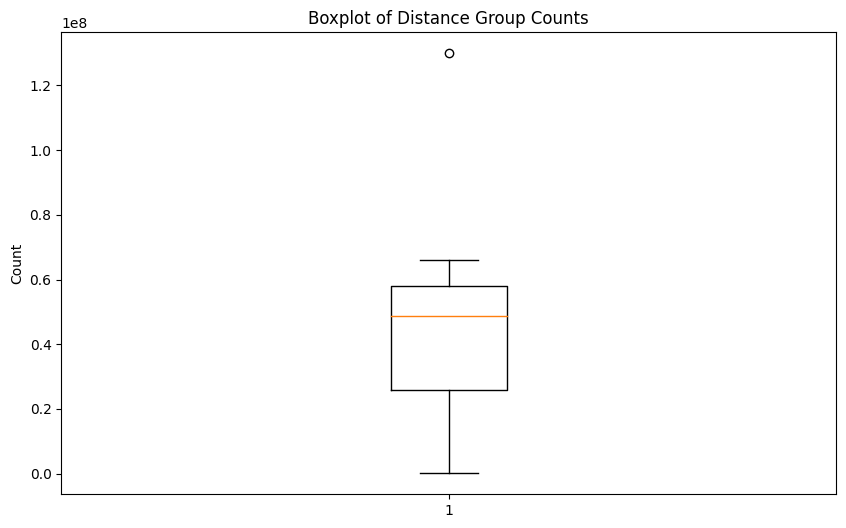

In [0]:
import matplotlib.pyplot as plt

# Pandas DataFrame에서 distance_in_kms 값을 추출하여 Boxplot 생성
plt.figure(figsize=(10, 6))
plt.boxplot(pandas_grouped_counts['count'])
plt.title('Boxplot of Distance Group Counts')
plt.ylabel('Count')
plt.show()

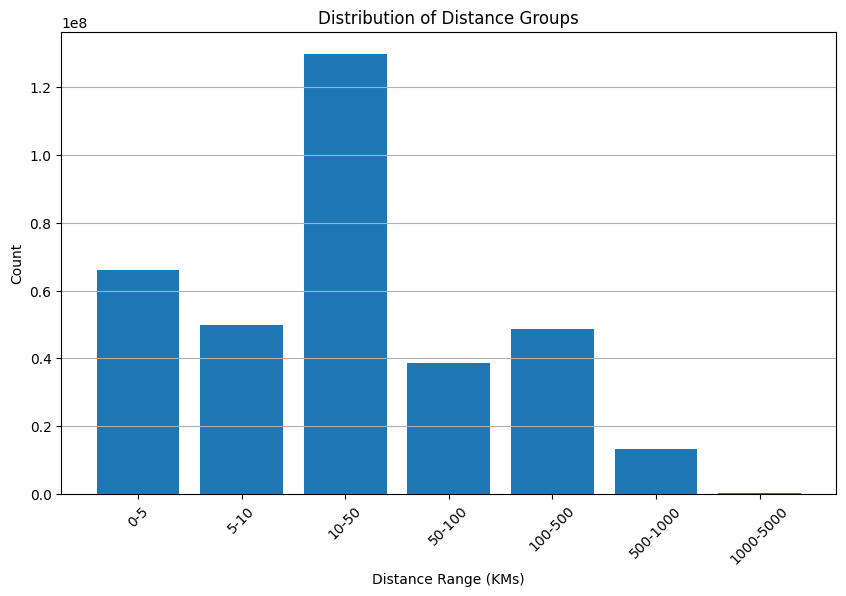

In [0]:
import matplotlib.pyplot as plt
import pandas as pd

# 지정된 순서대로 x축을 구성하기 위한 순서 리스트
order = ["0-5", "5-10", "10-50", "50-100", "100-500", "500-1000", "1000-5000"]

# distance_group 컬럼을 Categorical 타입으로 변환하고, 순서를 지정
pandas_grouped_counts['distance_group'] = pd.Categorical(
    pandas_grouped_counts['distance_group'], 
    categories=order, 
    ordered=True
)

# distance_group을 기준으로 DataFrame 정렬
pandas_grouped_counts = pandas_grouped_counts.sort_values('distance_group')

# Bar Plot 생성
plt.figure(figsize=(10, 6))
plt.bar(pandas_grouped_counts['distance_group'], pandas_grouped_counts['count'])
plt.title('Distribution of Distance Groups')
plt.xlabel('Distance Range (KMs)')
plt.ylabel('Count')
plt.xticks(rotation=45)  # x축 라벨을 회전하여 가독성 향상
plt.grid(axis='y')  # y축 기준으로 그리드 추가
plt.show()

In [0]:
%sql
SELECT
    MIN(distance_in_kms) AS min_distance,
    MAX(distance_in_kms) AS max_distance,
    AVG(distance_in_kms) AS avg_distance,
    PERCENTILE(distance_in_kms, 0.5) AS median_distance,
    STDDEV(distance_in_kms) AS stddev_distance
FROM
    hive_metastore.test.cali_cocount_distance_all_result_final_4;

min_distance,max_distance,avg_distance,median_distance,stddev_distance
0.0,1785.3869,71.90282552294326,19.488,136.73326294573332


In [0]:
%sql 
-- 캘리포니아 거리보다 큰 거리 건 

select * from hive_metastore.test.cali_cocount_distance_all_result_final_4
where distance_in_kms >= 1391 ;

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2,distance_in_kms
0x808447a8d9d728dd:0x77213111b097e752,0x872b6b6815b73667:0xd143f127ee9c24f0,1,144,398,2020-3,2020,3,1.482176040152979E-8,0.006944444444444444,0.002512562814070352,1177.2119102456727,7.070904133744148,3.0708546473519767,0.0018484288354898336,38.4636,-122.71794059999999,27.5877038,-135.1038998,1668.3167
0x80dcde9f3938f82d:0x75af24da1f03812d,0x872b6b6815b73667:0xd143f127ee9c24f0,1,581,398,2020-2,2020,2,1.482176040152979E-8,0.0017211703958691911,0.002512562814070352,291.77024969944387,5.675966676468238,2.4650410070568953,0.0010224948875255625,33.6943002,-117.8359967,27.5877038,-135.1038998,1785.3869


In [0]:
%sql 
-- 캘리포니아 거리보다 큰 거리 건 count

select count(*) from hive_metastore.test.cali_cocount_distance_all_result_final_4
where distance_in_kms >= 1391.1363 ;

count(*)
2


### 이상치 2건은 null로 변경

In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, when

# Spark 세션 생성
spark = SparkSession.builder \
    .appName("Nullify Distances") \
    .enableHiveSupport() \
    .getOrCreate()

# Hive 테이블 로드
df = spark.table("hive_metastore.test.cali_cocount_distance_all_result_final_4")

# distance_in_kms 컬럼에서 특정 값들을 null로 변경
updated_df = df.withColumn("distance_in_kms",
                           when(col("distance_in_kms").isin(1668.3167, 1785.3869), None)
                           .otherwise(col("distance_in_kms")))

# 변경된 데이터 확인 (선택적)

updated_df.filter(col("distance_in_kms").isNull()).show()


+--------------------+--------------------+--------+-----------+-----------+------------+----+-------+--------------------+--------------------+--------------------+------------------+-----------------+------------------+--------------------+----------+-------------------+----------+------------+---------------+
|            gmap_id1|            gmap_id2|co_count|gmap_count1|gmap_count2|year_quarter|year|quarter|             support|          confidence|         confidence2|              lift|         lift_log|        lift_log10|             jaccard|      lat1|               lon1|      lat2|        lon2|distance_in_kms|
+--------------------+--------------------+--------+-----------+-----------+------------+----+-------+--------------------+--------------------+--------------------+------------------+-----------------+------------------+--------------------+----------+-------------------+----------+------------+---------------+
|0x808447a8d9d728d...|0x872b6b6815b7366...|       1|      

In [0]:
a = updated_df.filter(col("distance_in_kms").isNull())
display(a)

gmap_id1,gmap_id2,co_count,gmap_count1,gmap_count2,year_quarter,year,quarter,support,confidence,confidence2,lift,lift_log,lift_log10,jaccard,lat1,lon1,lat2,lon2,distance_in_kms
0x808447a8d9d728dd:0x77213111b097e752,0x872b6b6815b73667:0xd143f127ee9c24f0,1,144,398,2020-3,2020,3,1.482176040152979E-8,0.006944444444444444,0.002512562814070352,1177.2119102456727,7.070904133744148,3.0708546473519767,0.0018484288354898336,38.4636,-122.71794059999999,27.5877038,-135.1038998,null
0x80dcde9f3938f82d:0x75af24da1f03812d,0x872b6b6815b73667:0xd143f127ee9c24f0,1,581,398,2020-2,2020,2,1.482176040152979E-8,0.0017211703958691911,0.002512562814070352,291.77024969944387,5.675966676468238,2.4650410070568953,0.0010224948875255625,33.6943002,-117.8359967,27.5877038,-135.1038998,null


In [0]:
# 변경된 DataFrame을 Hive 테이블에 저장
updated_df.write.mode("overwrite").saveAsTable("hive_metastore.test.cali_cocount_distance_all_result_final_5")

In [0]:
%sql 

select count(*) from hive_metastore.test.cali_cocount_distance_all_result_final_5; 

count(*)
346540103
